In [48]:
import pandas as pd
import plotly.express as px
import altair as alt

#alt.renderers.enable("png")

### Data Import

In [49]:
filepath = "/Users/noahrae-grant/nohrg/MRFRS-stats-analysis/data/clean/"
catdata = pd.read_csv(filepath + "catdata.csv", index_col=0)
hardtoplace = pd.read_csv(filepath + "hardtoplace.csv", index_col=0)
imagepath = "/Users/noahrae-grant/nohrg/MRFRS-stats-analysis/figs/"

### Summary Statistics

In [50]:
print(f"Total # cats: {len(catdata)}")

Total # cats: 3335


In [51]:
catdata["Age Group at Intake"].value_counts()

Age Group at Intake
Kitten    1954
Adult     1313
Senior      68
Name: count, dtype: int64

In [52]:
catdata["Sex"].value_counts()

Sex
Male       1705
Female     1622
Unknown       8
Name: count, dtype: int64

In [53]:
catdata["Hard to Place"].value_counts()

Hard to Place
No     1973
Yes    1362
Name: count, dtype: int64

In [54]:
catdata["Days in Custody"].mean()

np.float64(34.975412293853076)

In [55]:
catdata["Days in Custody"].median()

np.float64(25.0)

In [56]:
catdata["Days Onsite"].mean()

np.float64(14.025187406296851)

In [57]:
catdata["Days Onsite"].median()

np.float64(7.0)

In [58]:
catdata["Animal ID"].value_counts()

Animal ID
MER-A-5525    3
MER-A-3893    3
MER-A-891     3
MER-A-5411    3
MER-A-606     3
             ..
MER-A-2792    1
MER-A-3681    1
MER-A-2380    1
MER-A-1511    1
MER-A-5820    1
Name: count, Length: 3176, dtype: int64

# Cat Outcomes

## Q1: Are there cat groups that spend more time in the shelter than others? (eg. age, medical or behavioral issues)

In [59]:
catdata.head()

,Intake Date,Animal ID,Name,Primary Breed,Sex,Altered-Intake,Intake Type,Intake Sub-type,Intake By,Intake From (ID),...,Date of Birth,Age Group at Intake,Current Status,Current Location,Days in Custody,Days Onsite,Days Available,Days in Foster,Days Medical Care,Hard to Place
0,02/11/2022,MER-A-1290,Kitten,Domestic Shorthair,Male,No,Born in Care,Stray,mer_jfrey,NaN,...,02/11/2022,Kitten,Deceased,Died,1,0,0,1,0,No
1,06/17/2022,MER-A-1730,Matcha Tea,Domestic Medium Hair,Female,Yes,Stray In,Trapper Pickup,mer_jfrey,MER-P-3000,...,05/23/2022,Kitten,Healthy In Home,Adopted: ANDREW D Connor,55,3,2,52,1,No
2,02/11/2022,MER-A-1284,Triss,Domestic Shorthair,Female,Yes,Owner Surrender,Moving/Landlord,mer_bfox,MER-P-14744,...,08/11/2019,Adult,Healthy In Home,Adopted: Eden Richardson,9,9,3,0,6,No
3,08/05/2021,MER-A-804,Reece,Domestic Shorthair,Female,Yes,Owner Surrender,Unwanted litter,mer_jfrey,MER-P-14909,...,07/18/2021,Kitten,Healthy In Home,Adopted: Nilma Dominique,78,0,4,78,-4,No
4,06/28/2023,MER-A-2620,Mercury,Domestic Shorthair,Female,Yes,Stray In,Trapper Pickup,mer_jfrey,NaN,...,04/12/2023,Kitten,Healthy In Home,Adopted: Ava Galarraga,38,32,21,6,11,Yes


### One variable

In [60]:
def average_box_chart(data:pd.DataFrame, col_name:str, avg_type:str, group_type:str = "group"):
    if avg_type.lower() == "median":
        grouped_data = data[[col_name, "Days Onsite", "Days in Foster"]]\
            .groupby(col_name).median().reset_index()
    elif avg_type.lower() == "mean":
        grouped_data = data[[col_name, "Days Onsite", "Days in Foster"]]\
            .groupby(col_name).mean().reset_index()
    else:
        # default behavior will be mean
        grouped_data = data[[col_name, "Days Onsite", "Days in Foster"]]\
            .groupby(col_name).mean().reset_index()
        avg_type = "mean"

    num_cols = len(data[col_name].unique().tolist())

    fig = px.bar(
        grouped_data, 
        x=col_name, 
        y=["Days Onsite", "Days in Foster"],
        title=f"Time spent in MRFRS custody<br>by {col_name} ({avg_type.lower()})",
        text_auto=".3s", 
        width = num_cols * 130 + 100,
        height = 500,
        labels={"value":"Days"},
        barmode=group_type,
        color_discrete_sequence=px.colors.qualitative.D3
    ).update_layout(legend_title_text='Location')
    
    day_types = {"Days Onsite": "Onsite", "Days in Foster": "In Foster"}
    fig.for_each_trace(lambda t: t.update(name = day_types[t.name],
                                          legendgroup = day_types[t.name],
                                          hovertemplate = t.hovertemplate.replace(t.name, day_types[t.name])
                                     ))
    fig.update_layout(
        uniformtext_minsize=11,
        uniformtext_mode='show'
    )
    
    return fig

In [61]:

def alt_box_chart(data:pd.DataFrame, col_name:str, avg_type:str):
    if avg_type.lower() == "median":
        grouped_data = data[[col_name, "Days Onsite", "Days in Foster"]]\
            .groupby(col_name).median().reset_index()
    elif avg_type.lower() == "mean":
        grouped_data = data[[col_name, "Days Onsite", "Days in Foster"]]\
            .groupby(col_name).mean().reset_index()
    else:
        # default behavior will be mean
        grouped_data = data[[col_name, "Days Onsite", "Days in Foster"]]\
            .groupby(col_name).mean().reset_index()
        avg_type = "mean"
    
    
    num_cols = len(data[col_name].unique().tolist())
    
    fig = alt.Chart(grouped_data).mark_bar().encode(
        alt.X(f"{col_name}:N", axis=alt.Axis(labelAngle=0)),
        alt.Y("days:Q", title="Days in Custody"),
        alt.Color("type:N", title="Location"),
    ).transform_fold(
        as_=["type", "days"],
        fold=["Days in Foster", "Days Onsite"]
    ).properties(
        width = num_cols * 100 + 100,
        height = 400
    )
    
    text = alt.Chart(
        grouped_data,
        title=f"Time spent in MRFRS custody by {col_name} ({avg_type.lower()})"
    ).mark_text(
        dx=0,
        dy=10,
        color='white'
    ).encode(
        alt.X(f"{col_name}:N"),
        alt.Y("days:Q").stack('zero'),
        detail = 'type:N',
        text=alt.Text('days:Q', format='.1f')
    ).transform_fold(
        as_=["type", "days"],
        fold=["Days in Foster", "Days Onsite"]
    )
    return fig + text

In [62]:
alt_box_chart(catdata, "Intake Type", "mean")

alt.LayerChart(...)

- Age Group at Intake, Hard to Place, Intake Type, Sex and Age Group

- do the stupid kmodes thing again

In [63]:
intake_mean = average_box_chart(catdata, "Intake Type", "mean")
intake_mean.write_image(imagepath + "custody-intake-mean.svg")

KeyboardInterrupt: 

In [ ]:
intake_median = average_box_chart(catdata, "Intake Type", "median")
intake_median.write_image(imagepath + "custody-intake-median.svg")

In [ ]:
age_mean = average_box_chart(catdata, "Age Group at Intake", "mean")
age_mean.write_image(imagepath + "custody-age-mean.svg")

In [ ]:
age_median = average_box_chart(catdata, "Age Group at Intake", "median")
age_median.write_image(imagepath + "custody-age-median.svg")

In [ ]:
htp_mean = average_box_chart(catdata, "Hard to Place", "mean")
htp_mean.write_image(imagepath + "custody-htp-mean.svg")

In [ ]:
htp_median = average_box_chart(catdata, "Hard to Place", "median")
htp_median.write_image(imagepath + "custody-htp-median.svg")

In [ ]:
sex_mean = average_box_chart(catdata, "Sex", "mean")
sex_mean.write_image(imagepath + "custody-sex-mean.svg")

In [ ]:
sex_median = average_box_chart(catdata, "Sex", "median")
sex_median.write_image(imagepath + "custody-sex-median.svg")

### Two variables

In [95]:
def two_var_box_chart(data:pd.DataFrame, col_name:str, facet_col:str, avg_type:str):
    if avg_type.lower() == "median":
        grouped_data = data[[col_name, facet_col, "Days Onsite", "Days in Foster"]]\
            .groupby([col_name, facet_col]).median().reset_index()
    elif avg_type.lower() == "mean":
        grouped_data = data[[col_name, facet_col, "Days Onsite", "Days in Foster"]]\
            .groupby([col_name, facet_col]).mean().reset_index()
    else:
        # default behavior will be mean
        grouped_data = data[[col_name, facet_col, "Days Onsite", "Days in Foster"]]\
            .groupby([col_name, facet_col]).mean().reset_index()
        avg_type = "mean"

    num_cols = len(data[col_name].unique().tolist())
    num_facets = len(data[facet_col].unique().tolist())

    fig = px.bar(
        grouped_data, 
        x=col_name, 
        y=["Days Onsite", "Days in Foster"],
        title=f"Time spent in MRFRS custody ({avg_type.lower()})",
        text_auto=".3s", 
        width = num_cols * 160 + 200 + 150 * num_facets, 
        height = 500, 
        labels={"value":"Days"},
        facet_col=facet_col,
        barmode="group",
        color_discrete_sequence=px.colors.qualitative.D3
    ).update_layout(
        legend_title_text='Location'
    ).for_each_annotation(
        lambda a: a.update(text= f"{facet_col}: <br>" + a.text.split("=")[-1])
    ).for_each_xaxis(
        lambda x: x.update({'title': ''})
    )
    
    day_types = {"Days Onsite": "Onsite", "Days in Foster": "In Foster"}
    fig.for_each_trace(
        lambda t: t.update(
            name = day_types[t.name],
            legendgroup = day_types[t.name],
            hovertemplate = t.hovertemplate.replace(t.name, day_types[t.name])
    ))
    
    fig.add_annotation(
        showarrow=False,
        xanchor='center',
        xref='paper', 
        x=0.5, 
        yref='paper',
        y=-0.15,
        text=col_name,
        font = {"size":14}
    )
        
    return fig

In [96]:
age_htp_mean = two_var_box_chart(catdata, "Age Group at Intake", "Hard to Place", "mean")
age_htp_mean.write_image(imagepath + "custody-age-htp-mean.svg")

In [97]:
age_htp_median = two_var_box_chart(catdata, "Age Group at Intake", "Hard to Place", "median")
age_htp_median.write_image(imagepath + "custody-age-htp-mean.svg")

In [98]:
sex_age_mean = two_var_box_chart(catdata, "Sex", "Age Group at Intake", "mean")
sex_age_mean.write_image(imagepath + "custody-age-sex-mean.svg")

In [99]:
sex_age_median = two_var_box_chart(catdata, "Sex", "Age Group at Intake", "median")
sex_age_median.write_image(imagepath + "custody-age-sex-median.svg")

In [ ]:
testbase = alt.Chart(catdata, title=f"Length of stay by intake type")

bar = testbase.mark_bar().encode(
        alt.X("Days in Custody:Q", bin=True).bin(maxbins=30),
        alt.Y("count()")
).properties(width = 700, height = 200)

rule = testbase.mark_rule().encode(
        x="median(Days in Custody):Q",
        size=alt.value(1)
)

# rename x-axis
(bar + rule).facet(row="Intake Type").resolve_axis(x="independent")

alt.FacetChart(...)

In [ ]:
def histogram_time(data:pd.DataFrame, col_name:str):
    fig = alt.Chart(data, title=f"Length of stay by {col_name}").mark_bar().encode(
        alt.Y("Days in Custody"),
        
    )

In [100]:
kmodes_cols = catdata[["Sex", "Intake Type", "Age Group at Intake", "Hard to Place", "Primary Breed"]]

Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 1, iteration: 1/100, moves: 0, cost: 6427.0
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 2, iteration: 1/100, moves: 0, cost: 6427.0
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 3, iteration: 1/100, moves: 0, cost: 6427.0
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 4, iteration: 1/100, moves: 0, cost: 6427.0
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 5, iteration: 1/100, moves: 0, cost: 6427.0
Best run was number 1
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 1, iteration: 1/100, moves: 631, cost: 5024.0
Run 1, iteration: 2/100, moves: 376, cost: 5024.0
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 2, iteration: 1/100, moves: 0, cost: 5789.0
Init: initializing centroids
I

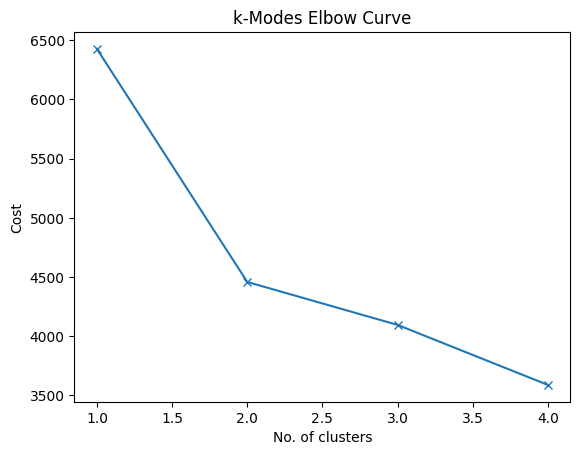

In [101]:
import numpy as np
from kmodes.kmodes import KModes
import matplotlib.pyplot as plt
%matplotlib inline

cost = []
K = range(1,5)
for k in list(K):
    kmode = KModes(n_clusters=k, init = "random", n_init = 5, verbose=1)
    kmode.fit_predict(kmodes_cols)
    cost.append(kmode.cost_)
    
plt.plot(K, cost, 'x-')
plt.xlabel('No. of clusters')
plt.ylabel('Cost')
plt.title('k-Modes Elbow Curve')
plt.show()

In [102]:
kmode = KModes(n_clusters=2, init = "random", n_init = 5, verbose=1)
clusters = kmode.fit_predict(kmodes_cols)

Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 1, iteration: 1/100, moves: 0, cost: 5114.0
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 2, iteration: 1/100, moves: 0, cost: 5092.0
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 3, iteration: 1/100, moves: 598, cost: 4953.0
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 4, iteration: 1/100, moves: 683, cost: 5151.0
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 5, iteration: 1/100, moves: 976, cost: 5028.0
Best run was number 3


In [103]:
catdata["kmodes (2 cluster)"] = clusters

In [105]:
kmodes_mean = average_box_chart(catdata, "kmodes (2 cluster)", "mean")
kmodes_mean.write_image(imagepath + "custody-kmodes.svg")

In [106]:
kmodes_median = average_box_chart(catdata, "kmodes (2 cluster)", "median")
kmodes_median.write_image(imagepath + "custody-kmodes.svg")

In [107]:
def trend_over_time(data:pd.DataFrame, col_name:str, intake_or_outcome:str, timeunit:str = "month"):
    fig = alt.Chart(
        data, 
        title=f"Trends over time: {col_name.lower()} and {intake_or_outcome} date"
    ).mark_line(
        point=True
    ).encode(
        alt.X(f"{intake_or_outcome[0].upper() + intake_or_outcome[1:].lower()} Date:T", timeUnit=timeunit),
        alt.Y("count()"),
        alt.Color(f"{col_name}").scale(scheme="category10")
    ).properties(
        width = 650
    )

    return fig

In [64]:
monthage = trend_over_time(catdata[catdata["Outcome Type"] == "Adoption"], "Age Group at Intake", "outcome", "month")
monthage.save(imagepath + "adoption-timeline-age.svg")
monthage.show()

alt.Chart(...)

In [65]:
yearage = trend_over_time(catdata[catdata["Outcome Type"] == "Adoption"], "Age Group at Intake", "outcome", "yearmonth")
yearage.save(imagepath + "adoption-timeline-age-yearmonth.svg")
yearage.show()

alt.Chart(...)

## Q2: Where do the cats come from (eg. surrender, trapped, or transfer) vs what are their outcomes?

pie for totals, heatmaps for comp

In [ ]:
def alt_pie_chart(data:pd.DataFrame, col_name:str, show_labels:bool = True, facet_col:str = None):
    base = alt.Chart(
        data,
        title = f"Cats by {col_name}"
    ).encode(
        alt.Theta("count()").stack(True),
        alt.Color(col_name).scale(scheme="category20")
    )
    
    pie = base.mark_arc(outerRadius=150)
    
    if show_labels:
        text = base.mark_text(
            radius=165, size=15
        ).encode(
            text="count()"
        ).properties(
            height = 400
        )
    else:
        if facet_col is not None:
            return pie.facet(
                        facet_col
                    ).configure_legend(
                        orient="right",
                        offset=60
                    ).resolve_scale(
                        theta="independent"
                    )
        else:
            return pie.configure_legend(
                        orient="right",
                        offset=60
                    ).resolve_scale(
                        theta="independent"
                    )
    
    
    if facet_col is not None:
        return (pie + text
                ).facet(
                    facet_col
                ).configure_legend(
                    orient="right",
                    offset=60
                ).resolve_scale(
                    theta="independent"
                )
    else:
        return (pie + text
                ).configure_legend(
                    orient="right",
                    offset=60
                ).resolve_scale(
                    theta="independent"
                )

In [ ]:
def px_pie_chart(data:pd.DataFrame, col_name:str, show_labels:bool = True, facet_col:str = None):
    fig = px.pie(
        data,
        
    )

In [66]:
# origin
origin_pie = alt_pie_chart(catdata, "Intake Type")
origin_pie.save(imagepath + "pie-intake.svg")
origin_pie.show()

alt.LayerChart(...)

In [67]:
stray_origin_pie = alt_pie_chart(
    catdata[(catdata["Intake Type"] != "Owner Surrender") & (catdata["Intake Type"] != "Adoption Return")], 
    "Intake Sub-type", 
    True, 
    "Intake Type")
stray_origin_pie.save(imagepath + "pie-intake-strays.svg")
stray_origin_pie.show()

alt.FacetChart(...)

In [68]:
surrender_origin_pie = alt_pie_chart(catdata[(catdata["Intake Type"] == "Owner Surrender") | (catdata["Intake Type"] == "Adoption Return")], "Intake Sub-type", False, "Intake Type")
surrender_origin_pie.save(imagepath + "pie-intake-surrenders.svg")
surrender_origin_pie.show()

alt.FacetChart(...)

In [69]:
outcomes_pie = alt_pie_chart(catdata, "Outcome Type", False)
outcomes_pie.save(imagepath + "pie-outcome.svg")
outcomes_pie.show()

alt.Chart(...)

In [70]:
outcomes_intaketype_pie = alt_pie_chart(catdata, "Outcome Type", False, "Intake Type")
outcomes_intaketype_pie.save(imagepath + "pie-outcome-byintake.svg")
outcomes_intaketype_pie.show()

alt.FacetChart(...)

In [72]:
def alt_heatmap(data:pd.DataFrame, x_axis_col:str, y_axis_col:str, title:str = None):
    base = alt.Chart(
        data,
        ).encode(
            alt.X(x_axis_col, axis=alt.Axis(labelAngle=0)),
            alt.Y(y_axis_col),
        ).properties(
            width=500,
            height = 500
        )
    
    heatmap = base.mark_rect().encode(
        alt.Color("count()")
        .scale(scheme='tealblues')
        .title("Number of cats")
    )
    
    text = base.mark_text(baseline="middle").encode(
        alt.Text('count():Q', format=".0f"),
        color=alt.ColorValue("#011F1B")
    )
    
    if title is not None:
        return (heatmap + text).configure_text(fontSize=14).properties(title=title)
    else:
        return (heatmap + text).configure_text(fontSize=14).properties(title = f"{x_axis_col} vs {y_axis_col}")

In [73]:
intakevoutcome = alt_heatmap(catdata, "Intake Type", "Outcome Type", "Where do cats come from vs where do they end up")
intakevoutcome.save(imagepath + "heatmap_intakevoutcome.svg")
intakevoutcome.show()

alt.LayerChart(...)

In [74]:
ivo_nonadopt = alt_heatmap(catdata[catdata["Outcome Type"] != "Adoption"], "Intake Type", "Outcome Type", "Where do cats come from vs where do they end up (nonadoptions only)")
ivo_nonadopt.save(imagepath + "heatmap_ivo_nonadopt.svg")
ivo_nonadopt.show()

alt.LayerChart(...)

In [75]:
htp_outcomes = alt_heatmap(catdata[catdata["Hard to Place"] == "Yes"], "Intake Type", "Outcome Type", "Placement of 'hard to place' cats")
htp_outcomes.save(imagepath + "heatmap_htp_ivo.svg")
htp_outcomes.show()

alt.LayerChart(...)

In [76]:
htp_na_outcomes = alt_heatmap(catdata[(catdata["Hard to Place"] == "Yes") & (catdata["Outcome Type"] != "Adoption")], "Intake Type", "Outcome Type", "Nonadoption outcomes of 'hard to place' cats")
htp_na_outcomes.save(imagepath + "heatmap_htp_ivo_nonadopt.svg")
htp_na_outcomes.show()

alt.LayerChart(...)

In [ ]:
catdata.columns

Index(['Intake Date', 'Animal ID', 'Name', 'Primary Breed', 'Sex',
       'Altered-Intake', 'Intake Type', 'Intake Sub-type', 'Intake By',
       'Intake From (ID)', 'Intake From Name', 'Outcome Date', 'Outcome Time',
       'Altered-Outcome', 'Outcome Type', 'Outcome Sub-type',
       'Outcome To (ID)', 'Outcome To Name', 'Outcome By', 'Date of Birth',
       'Age Group at Intake', 'Current Status', 'Current Location',
       'Days in Custody', 'Days Onsite', 'Days Available', 'Days in Foster',
       'Days Medical Care', 'Hard to Place', 'kmodes (2 cluster)'],
      dtype='object')

## Q3: What are the outcomes for cats that have been returned, particularly those who are returned multiple times?

In [77]:
returned_catIDs = catdata[catdata["Intake Type"] == "Adoption Return"]["Animal ID"].to_list()
returnedcats = catdata[catdata["Animal ID"].isin(returned_catIDs)].copy()

In [81]:
def returns_origin_type(ani_id):
    origin = returnedcats[(returnedcats["Animal ID"] == ani_id) & (returnedcats["Intake Type"] != "Adoption Return")]["Intake Type"].values
    return origin[0]
returnedcats["Origins"] = returnedcats["Animal ID"].apply(returns_origin_type)

In [78]:
returnedcats["Year"] = pd.to_datetime(returnedcats["Intake Date"]).dt.year.astype(str)

In [83]:
rc_origins = alt_pie_chart(returnedcats[returnedcats["Intake Type"] != "Adoption Return"], "Intake Type")
rc_origins.save(imagepath + "RC_pie_origins.svg")
rc_origins.show()

alt.LayerChart(...)

In [ ]:
rc_returns = alt_pie_chart(returnedcats[returnedcats["Intake Type"] == "Adoption Return"], "Intake Sub-type", facet_col="Origins")
rc_returns.save(imagepath + "RC_subtypes_byorigin.svg")
rc_returns.show()

alt.FacetChart(...)

In [89]:
rc_reasons = alt_pie_chart(returnedcats[returnedcats["Intake Type"] == "Adoption Return"], "Intake Sub-type")
rc_reasons.save(imagepath + "RC_subtypes.svg")
rc_reasons.show()

alt.LayerChart(...)

In [90]:
rc_new_outcomes = alt_pie_chart(returnedcats[returnedcats["Intake Type"] == "Adoption Return"], "Outcome Type")
rc_new_outcomes.save(imagepath + "RC_newoutcomes.svg")
rc_new_outcomes.show()

alt.LayerChart(...)

In [ ]:
returnedcats[returnedcats["Outcome Type"] == "Euthanasia"]

,Intake Date,Animal ID,Name,Primary Breed,Sex,Altered-Intake,Intake Type,Intake Sub-type,Intake By,Intake From (ID),...,Current Location,Days in Custody,Days Onsite,Days Available,Days in Foster,Days Medical Care,Hard to Place,kmodes (2 cluster),Origins,Year
2739,12/15/2022,MER-A-2016,Moonshine,Domestic Shorthair,Male,Yes,Adoption Return,Housesoiling,mer_jfrey,MER-P-18455,...,NaN,3,0,3,3,-3,Yes,1,Stray In,2022
2978,04/24/2025,MER-A-3893,Jefferson,Domestic Shorthair,Male,Yes,Owner Surrender,Unrealistic expectations,mer_jfrey,MER-P-9457,...,NaN,1,1,0,0,1,Yes,1,Stray In,2025


In [91]:
rc_trends = trend_over_time(returnedcats[returnedcats["Intake Type"] == "Adoption Return"], "Year", "intake")
rc_trends.save(imagepath + "RC_trends_year.svg")
rc_trends

alt.Chart(...)

Spikes: Aug/Sept, Apr/May

In [92]:
rc_trends_mo = trend_over_time(returnedcats[returnedcats["Intake Type"] == "Adoption Return"], "Intake Type", "intake")
rc_trends_mo = rc_trends_mo.properties(title="What months have the most adoption returns?").encode(color=alt.Color(legend=None))
rc_trends_mo.save(imagepath + "RC_trends_month.svg")
rc_trends_mo

alt.Chart(...)

In [93]:
return_counts = returnedcats["Animal ID"].value_counts()
multi_returns = (return_counts[return_counts == 3].index.to_list())

In [ ]:
alt_pie_chart(returnedcats[(returnedcats["Animal ID"].isin(multi_returns)) ], "Outcome Type", facet_col="Intake Type")


alt.FacetChart(...)